# Sampling from multimodal distributions

In this recipe we will demonstrate how one can use zeus with the Moves interface to sample efficiently from challenging high-dimensional multimodal distributions.

We will start by defining the target distribution, a 10-dimensional mixture of Normal distributions with huge valleys of almost-zero probability between the modes.
This is an extremelly difficult target to sample from and most methods would fail.

In [3]:
import zeus 

import numpy as np
import matplotlib.pyplot as plt


ndim = 10
nmodes = 3

# Define the random means and variances of the Gaussian Mixture components.
means = []
ivars = []
for i in range(nmodes):
    means.append(-15.0 + 30.0 * np.random.rand(ndim))
    ivars.append(1.0/np.random.rand(ndim))

# The log probability density of the Gaussian Mixture
def log_prob(x):
    lnprobs = [-np.sum(ivars[i]*(x - means[i]) ** 2)/2 for i in range(nmodes)]
    return np.logaddexp.reduce(lnprobs)

## A failed attempt

Now lets run ``zeus`` for 1000 steps using 100 walkers and see what happens:

Initialising ensemble of 400 walkers...
Sampling progress : 100%|██████████| 1000/1000 [01:10&lt;00:00, 14.20it/s]


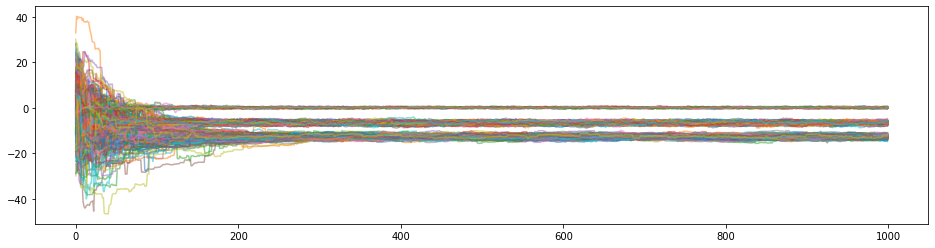

In [5]:
nwalkers = 400
nsteps= 1000

# The starting positions of the walkers
start = np.random.randn(nwalkers, ndim) * 10.0

# Initialise the Ensemble Sampler
sampler = zeus.EnsembleSampler(nwalkers, ndim, log_prob)
# Run MCMC
sampler.run_mcmc(start, nsteps)

# Get the samples
samples = sampler.get_chain()

# Plot the walker trajectories for the first parameter of the 10
plt.figure(figsize=(16,4))
plt.plot(samples[:,:,0],alpha=0.5)
plt.show()

As you can see, once the walkers have found the modes/peaks of the Gaussian Mixture they stay stranded there, unable to jump to the other modes.
This is a huge issue because it prevents the walkers from distributing the probability mass fairly among the peaks thus leading to biased results.

## The clever way...

Now that we know that our target is multimodal, and that the default ``DifferentialMove`` cannot facilitate jumps
between modes we can use a few more advanced moves such as the ``GlobalMove`` and ``LocalMove``.

Although the ``GlobalMove`` and ``LocalMove`` are very powerful tools, they are not well suited during the burnin phase.
For that reason we will use the default ``DifferentialMove`` during burnin and then switch to the more sophisticated tools.

Initialising ensemble of 400 walkers...
Sampling progress : 100%|██████████| 1000/1000 [01:13&lt;00:00, 13.69it/s]
Initialising ensemble of 400 walkers...
Sampling progress : 100%|██████████| 1000/1000 [04:06&lt;00:00,  4.05it/s]


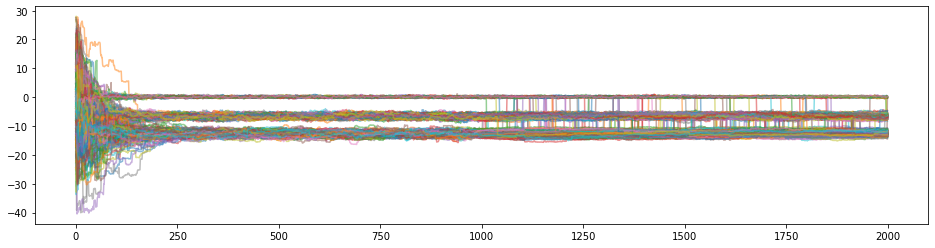

In [6]:
# Initialise the Ensemble Sampler using the default ``DifferentialMove``
sampler = zeus.EnsembleSampler(nwalkers, ndim, log_prob)
# Run MCMC
sampler.run_mcmc(start, nsteps)

# Get the burnin samples
burnin = sampler.get_chain()

# Set the new starting positions of walkers based on their last positions
start = burnin[-1]

# Initialise the Ensemble Sampler using the advanced ``LocalMove`` and ``GlobalMove``.
# The 0.75 and 0.25 factors mean that there is a 75% probability of using the Global move and 25% probability of using the Local one.
sampler = zeus.EnsembleSampler(nwalkers, ndim, log_prob, moves=[(zeus.moves.GlobalMove(), 0.75), (zeus.moves.LocalMove(), 0.25)])
# Run MCMC
sampler.run_mcmc(start, nsteps)

# Get the samples and combine them with the burnin phase for plotting purposes
samples = sampler.get_chain()
total_samples = np.concatenate((burnin, samples))

# Plot the walker trajectories for the first parameter of the 10
plt.figure(figsize=(16,4))
plt.plot(total_samples[:,:,0],alpha=0.5)
plt.show()

You can see that the moment we switched to the ``GlobalMove`` and ``LocalMove`` the walkers begun to jump from mode to mode frequently.

Lets now plot the 2D distribution of the first couple parameters along with the walker trajectories.

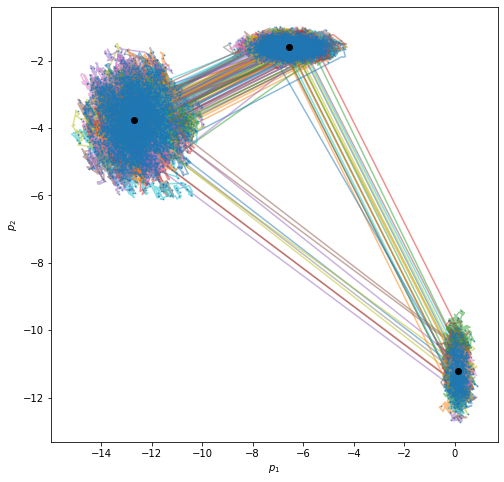

In [7]:
chain = sampler.get_chain(flat=True, discard=0.5)

plt.figure(figsize=(8,8))
plt.plot(samples[nsteps//2:,:,0], samples[nsteps//2:,:,1], alpha=0.5, zorder=1)
plt.scatter(x=chain[::10, 0], y=chain[::10, 1], s=1, alpha=0.5, zorder=2)
plt.scatter(np.array(means)[:,0], np.array(means)[:,1], color='k', zorder=3)
plt.xlabel(r"$p_{1}$")
plt.ylabel(r"$p_{2}$")
plt.show()

We can also calculate the approximate maximum distance between the modes:

In [8]:
maximum = 0.0
for i in range(nmodes):
    for j in range(nmodes):
        distance = np.linalg.norm(means[i]-means[j])
        if distance > maximum:
            maximum = distance
print(maximum)

41.040249893354634


Using the advanced moves, the walkers can jump distances in parameter space close to 40 standard deviations.